In [1]:
import test_yolo_rev
import matplotlib.pyplot as plt
import zipfile
import main
import os
from tqdm import tqdm
import shutil

/opt/conda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [5]:
shutil.rmtree('./0116_testing/')

In [4]:
# zip_filename = '0116_testing.zip'
# image_dir_path = os.path.join('/home/jovyan/models/YoloV2/', zip_filename.split('.')[0])

In [6]:
##### unzip all the file #####
zip_filename = '0116_02_testing.zip'
image_zip_path = os.path.join('/home/jovyan/models/YoloV2/', zip_filename)
with zipfile.ZipFile(image_zip_path, 'r') as img_zp:
    img_zp.extractall()

In [16]:
image_dir_path = os.path.join('/home/jovyan/models/YoloV2/', zip_filename.split('.')[0])
image_dirs = []
predict_txt_dirs = []
gt_txt_dirs = []
output = {}
for root, dirs, files in os.walk(image_dir_path):
    for name in dirs:
        if name == 'predict_txt':
            predict_txt_dirs.append(os.path.join(root, name))
        elif name == 'images':
            image_dirs.append(os.path.join(root, name))
        elif name == 'gt_txt':
            gt_txt_dirs.append(os.path.join(root, name))
            
for i, p in tqdm(zip(image_dirs, predict_txt_dirs)):
    args = test_yolo_rev.parser.parse_known_args()[0]
    args.weights_path= '/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5'
    args.test_path = i
    args.score_threshold = 0.6
    args.output_path = '/home/jovyan/models/YoloV2/test_img/'  ### 可有可無，因為test_yolo_rev存照片的code已註解
    args.classes_path = '/home/jovyan/at073-group49/AT073_49_Orig_Trash/data/class_list.txt'
    args.predict_txt_dir = p
    output['{}_{}'.format(i.split('/')[-3], i.split('/')[-2])] = test_yolo_rev._main(args)
    print('Finish {}_{} images prediction!!!'.format(i.split('/')[-3], i.split('/')[-2]))
    
print('Finish Predict!!!!!!')

0it [00:00, ?it/s]

/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


1it [00:14, 14.50s/it]

Finish 0116_02_testing_Person images prediction!!!
/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


2it [00:31, 15.23s/it]

Finish Bottle_close_shot images prediction!!!
/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


3it [00:50, 16.36s/it]

Finish Bottle_long_shot images prediction!!!
/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


4it [01:19, 20.17s/it]

Finish Paper_close_shot images prediction!!!
/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


5it [01:53, 24.24s/it]

Finish Paper_long_shot images prediction!!!
/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


6it [02:20, 25.22s/it]

Finish Metal_close_shot images prediction!!!
/home/jovyan/at073-group49/shared_temp/trained_stage_1_0116a.h5 model, anchors, and classes loaded.


7it [02:53, 27.43s/it]

Finish Metal_long_shot images prediction!!!
Finish Predict!!!!!!


In [17]:
##### draw the grams #####
## collect the images to a summary directory 'all_images' 'long_shot_images' 'close_shot_images', delete after
## the grams drawed.
all_images = '/home/jovyan/models/YoloV2/0116_02_testing/all_images/'
long_shot_images = '/home/jovyan/models/YoloV2/0116_02_testing/long_shot_images/'
close_shot_images = '/home/jovyan/models/YoloV2/0116_02_testing/close_shot_images/'
dirs_ls = ['gt_txt', 'images', 'predict_txt']
for path in [all_images, long_shot_images, close_shot_images]:
    os.mkdir(path, 0o755)
    for dirs in dirs_ls:
        dirs_path = os.path.join(path, dirs)
        os.mkdir(dirs_path, 0o755)
        if dirs == 'gt_txt':
            gt_txt_dirs.append(dirs_path)
        elif dirs == 'images':
            image_dirs.append(dirs_path)
        elif dirs == 'predict_txt':
            predict_txt_dirs.append(dirs_path)

for root, dirs, file in os.walk(image_dir_path):
    d = root.split('/')[-1]
    image_type = root.split('/')[-2]
    if image_type == 'close_shot':
        if d == 'predict_txt':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(close_shot_images, d))
        elif d == 'images':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(close_shot_images, d))
        elif d == 'gt_txt':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(close_shot_images, d))
    elif image_type == 'long_shot':
        if d == 'predict_txt':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(long_shot_images, d))
        elif d == 'images':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(long_shot_images, d))
        elif d == 'gt_txt':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(long_shot_images, d))
    elif image_type == 'Person':
        if d == 'predict_txt':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(long_shot_images, d))
        elif d == 'images':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(long_shot_images, d))
        elif d == 'gt_txt':
            for f in file:
                shutil.copy(os.path.join(root, f), os.path.join(all_images, d))
                shutil.copy(os.path.join(root, f), os.path.join(long_shot_images, d))
                
print('finish copying')

finish copying


In [10]:
len(os.listdir('/home/jovyan/models/YoloV2/0116_02_testing/all_images/images'))

847

mAP of 0116_02_testing_Person
13.83% = Bottle AP  
6.90% = Metal AP  
2.50% = Paper AP  
45.41% = Person AP  
mAP = 17.16%


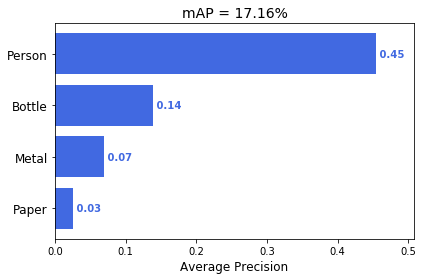

mAP of Bottle_close_shot
59.72% = Bottle AP  
mAP = 59.72%


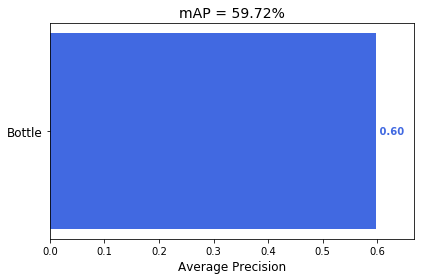

mAP of Bottle_long_shot
25.06% = Bottle AP  
mAP = 25.06%


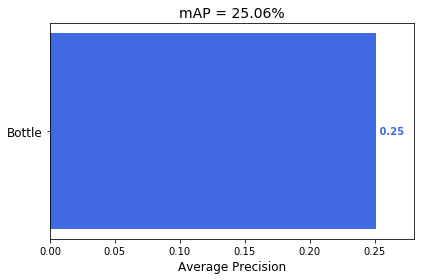

mAP of Paper_close_shot
71.61% = Paper AP  
mAP = 71.61%


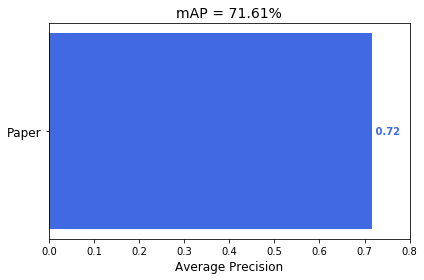

mAP of Paper_long_shot
1.88% = Paper AP  
mAP = 1.88%


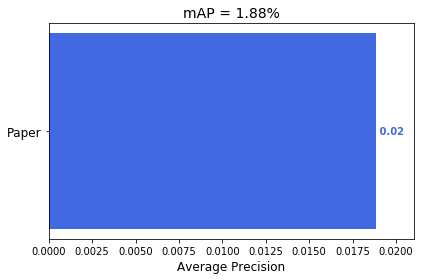

mAP of Metal_close_shot
68.69% = Metal AP  
mAP = 68.69%


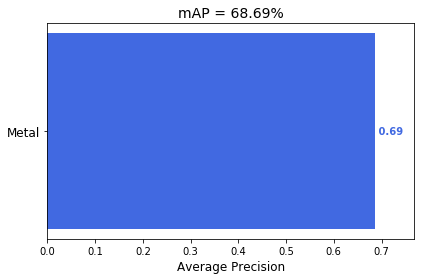

mAP of Metal_long_shot
16.08% = Metal AP  
mAP = 16.08%


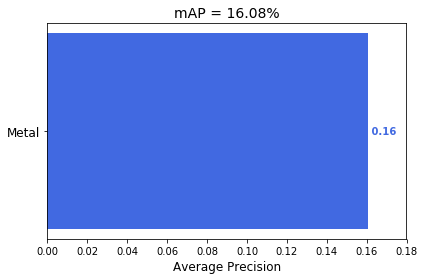

mAP of 0116_02_testing_all_images
31.67% = Bottle AP  
24.95% = Metal AP  
29.50% = Paper AP  
43.48% = Person AP  
mAP = 32.40%


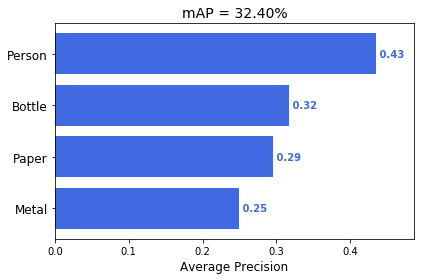

mAP of 0116_02_testing_long_shot_images
18.58% = Bottle AP  
9.25% = Metal AP  
1.29% = Paper AP  
43.55% = Person AP  
mAP = 18.17%


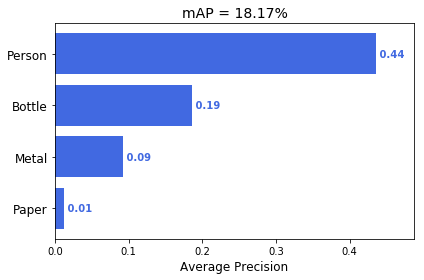

mAP of 0116_02_testing_close_shot_images
47.22% = Bottle AP  
54.82% = Metal AP  
64.40% = Paper AP  
mAP = 55.48%


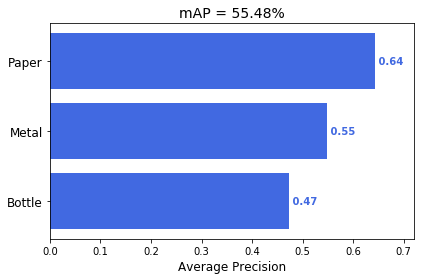

In [18]:
for i, p, g in zip(image_dirs, predict_txt_dirs, gt_txt_dirs):
    print('mAP of {}_{}'.format(i.split('/')[-3], i.split('/')[-2]))
    args = main.parser.parse_known_args()[0]
    args.no_animation= '-na'
#     args.no_plot = 
    args.image_dir = i + '/'
    args.ground_truth = g + '/'
    args.prediction = p + '/'
    main.__main(args)

In [15]:
shutil.rmtree(all_images)
shutil.rmtree(long_shot_images)
shutil.rmtree(close_shot_images)

In [28]:
##### zip the file for the grams #####
zip_dir = 'result_0116a_v2/'
filename = zip_dir.split('/')[-2] + '.zip'
with zipfile.ZipFile(filename,'w') as z:
    for root, dirs, files in os.walk(zip_dir):
        for file in files:
            z.write(os.path.join(root,file))

/opt/conda/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


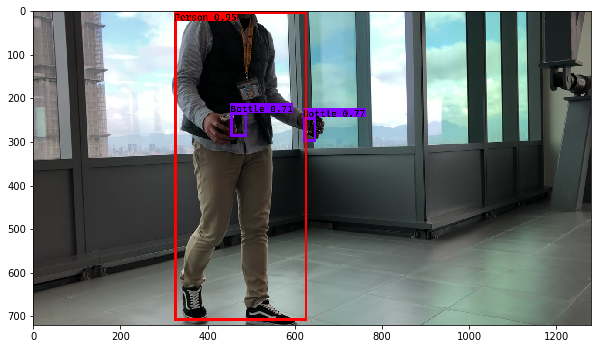

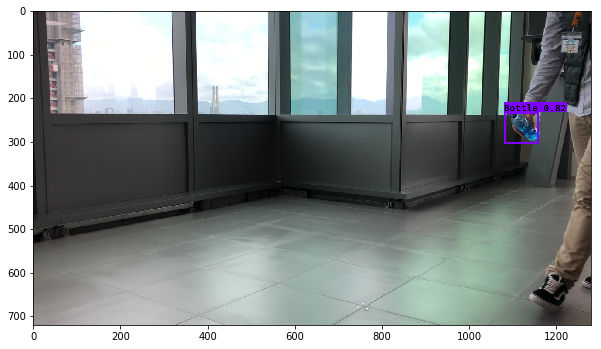

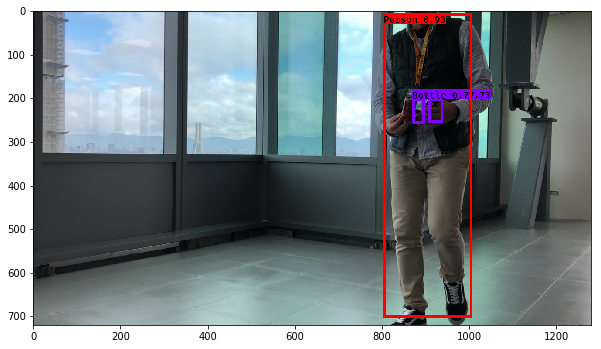

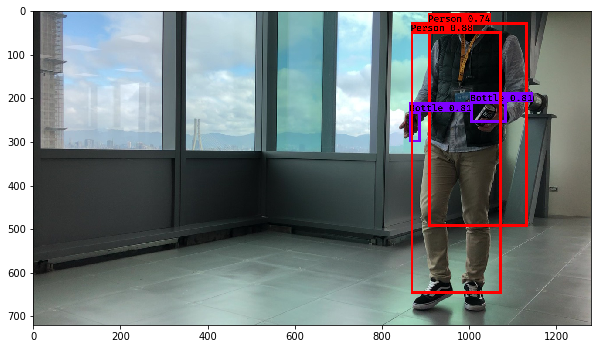

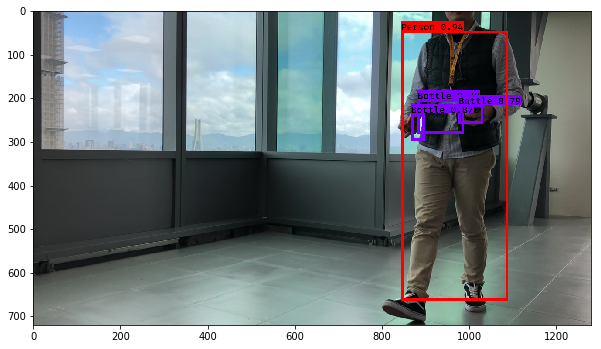

...

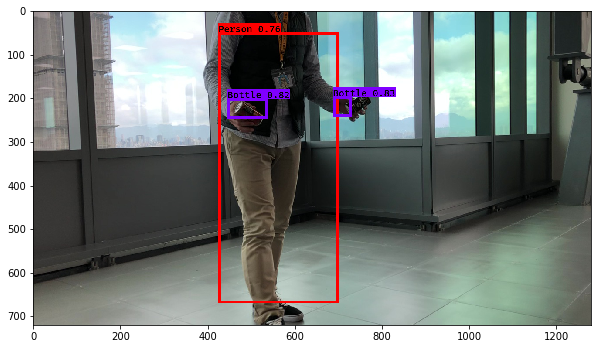

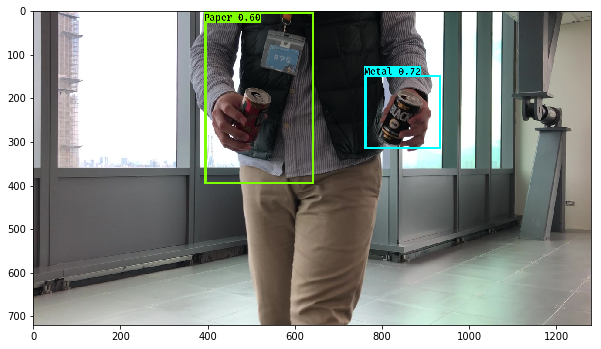

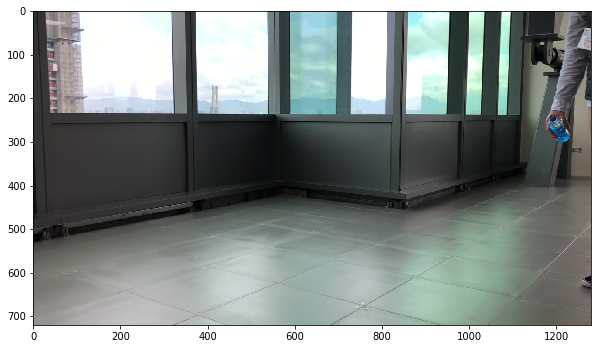

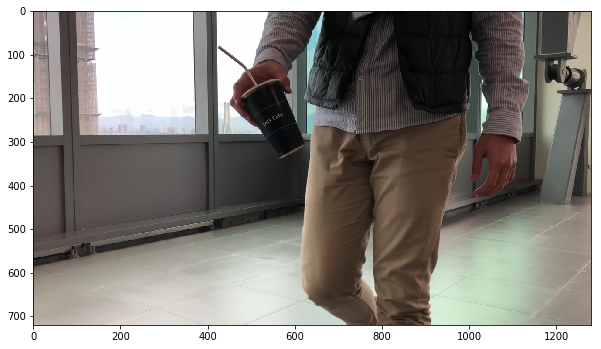

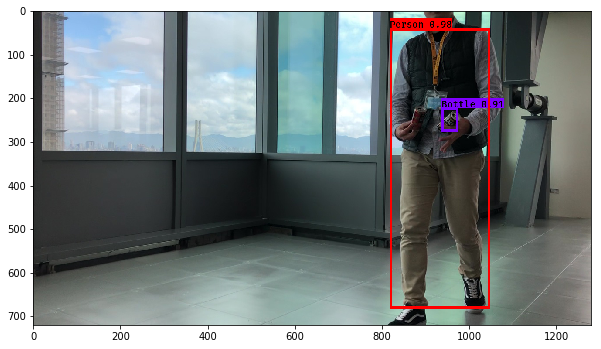

In [19]:
for image in output['0116_02_testing_Person'][0]:
    plt.figure(figsize = (10,15))
    plt.imshow(image)